In [346]:
import pandas as pd
import numpy as np
import re
import ast
import missingno as msno

In [347]:
zomato_raw = pd.read_csv("zomato.csv", encoding="utf-8")
zomato_raw

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars,Whitefield
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars,Whitefield
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars,Whitefield
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars,Whitefield


In [348]:
zomato_raw.columns

Index(['url', 'address', 'name', 'online_order', 'book_table', 'rate', 'votes',
       'phone', 'location', 'rest_type', 'dish_liked', 'cuisines',
       'approx_cost(for two people)', 'reviews_list', 'menu_item',
       'listed_in(type)', 'listed_in(city)'],
      dtype='object')

In [349]:
zomato_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [350]:
zomato_raw.isnull().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [351]:
zomato_cleaned = zomato_raw.copy()

# Drop listed_in(city)

In [352]:
# Since we have location column with more specific details, we can drop the listed_in(city) column
zomato_cleaned.drop("listed_in(city)", axis=1, inplace=True)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Online Order

In [353]:
zomato_cleaned["online_order"].unique()

array(['Yes', 'No'], dtype=object)

In [354]:
zomato_cleaned["online_order"] = zomato_cleaned["online_order"].map({"Yes":1,"No":0})
zomato_cleaned["online_order"].head()

0    1
1    1
2    1
3    0
4    0
Name: online_order, dtype: int64

# Book Table

In [355]:
zomato_cleaned["book_table"].unique()

array(['Yes', 'No'], dtype=object)

In [356]:
zomato_cleaned["book_table"] = zomato_cleaned["book_table"].map({"Yes":1,"No":0})
zomato_cleaned["book_table"].head()

0    1
1    0
2    0
3    0
4    0
Name: book_table, dtype: int64

# Rate 

In [357]:
zomato_cleaned["rate"].unique()

array(['4.1/5', '3.8/5', '3.7/5', '3.6/5', '4.6/5', '4.0/5', '4.2/5',
       '3.9/5', '3.1/5', '3.0/5', '3.2/5', '3.3/5', '2.8/5', '4.4/5',
       '4.3/5', 'NEW', '2.9/5', '3.5/5', nan, '2.6/5', '3.8 /5', '3.4/5',
       '4.5/5', '2.5/5', '2.7/5', '4.7/5', '2.4/5', '2.2/5', '2.3/5',
       '3.4 /5', '-', '3.6 /5', '4.8/5', '3.9 /5', '4.2 /5', '4.0 /5',
       '4.1 /5', '3.7 /5', '3.1 /5', '2.9 /5', '3.3 /5', '2.8 /5',
       '3.5 /5', '2.7 /5', '2.5 /5', '3.2 /5', '2.6 /5', '4.5 /5',
       '4.3 /5', '4.4 /5', '4.9/5', '2.1/5', '2.0/5', '1.8/5', '4.6 /5',
       '4.9 /5', '3.0 /5', '4.8 /5', '2.3 /5', '4.7 /5', '2.4 /5',
       '2.1 /5', '2.2 /5', '2.0 /5', '1.8 /5'], dtype=object)

In [358]:
(zomato_cleaned["rate"] == "-").sum()

np.int64(69)

In [359]:
((zomato_cleaned["rate"] == "-") & (zomato_cleaned["votes"] == 0)).sum()

np.int64(69)

In [360]:
zomato_cleaned.loc[(zomato_cleaned["rate"] == "-") & (zomato_cleaned["votes"] == 0), "rate"] = "NEW"
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [361]:
zomato_cleaned["rate"] = zomato_cleaned["rate"].str.replace(r"\s*/5", "",regex=True)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [362]:
zomato_cleaned["rate"].unique()

array(['4.1', '3.8', '3.7', '3.6', '4.6', '4.0', '4.2', '3.9', '3.1',
       '3.0', '3.2', '3.3', '2.8', '4.4', '4.3', 'NEW', '2.9', '3.5', nan,
       '2.6', '3.4', '4.5', '2.5', '2.7', '4.7', '2.4', '2.2', '2.3',
       '4.8', '4.9', '2.1', '2.0', '1.8'], dtype=object)

In [363]:
mask = zomato_cleaned["rate"] != "NEW"
zomato_cleaned.loc[mask, "rate"] = pd.to_numeric(zomato_cleaned.loc[mask, "rate"], errors="coerce")
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Votes

In [364]:
zomato_cleaned["votes"].isnull().sum()

np.int64(0)

In [365]:
zomato_cleaned["votes"] = zomato_cleaned["votes"].astype(int)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Phone number

In [366]:
zomato_cleaned_phone = zomato_cleaned[~zomato_cleaned["phone"].str.contains("[0-9+]", na=False)]
zomato_cleaned_phone["phone"].unique()

array([nan], dtype=object)

In [367]:
comparision_df = pd.DataFrame()
comparision_df["actual_phone"] = zomato_cleaned["phone"]

In [368]:
def extract_numbers_iterative(text):
    if pd.isna(text):
        return []
    
    tokens = str(text).split()
    
    found_numbers = []
    i = 0
    while i < len(tokens):
        current_token = tokens[i]
        next_token = tokens[i+1] if (i + 1) < len(tokens) else ""
        
        if (current_token == "+91" or current_token == "091") and next_token.isdigit() and len(next_token) == 10:
            found_numbers.append("+91 " + next_token)
            i += 2
            continue
            
        elif re.match(r"^0\d{2}$", current_token) and next_token.isdigit() and len(next_token) == 8:
            formatted_number = f"{current_token}-{next_token[:4]}-{next_token[4:]}"
            found_numbers.append(formatted_number)
            i += 2
            continue
         
        elif current_token == "00" and next_token.startswith("080") and next_token.isdigit() and len(next_token) == 11:
            formatted_number = f"{next_token[0:3]}-{next_token[3:7]}-{next_token[7:11]}"
            found_numbers.append(formatted_number)
            i += 2
            continue
        
        elif current_token == "00" and len(next_token) == 10 and next_token.isdigit() and not next_token.startswith("0"):
             found_numbers.append("+91 " + next_token)
             i += 2
             continue
        
        elif current_token == "00" and next_token.startswith("91") and next_token.isdigit() and len(next_token) == 12:
             found_numbers.append("+91 " + next_token[2:])
             i += 2
             continue
        
        elif re.match(r"^18\d{9}$", current_token):
            formatted_number = f"{current_token[0:4]}-{current_token[4:7]}-{current_token[7:11]}"
            found_numbers.append(formatted_number)
            i += 2
            continue
        
        elif re.match(r"^0\d{10}$", current_token):
             found_numbers.append("+91 " + current_token[1:])
             i += 1
             continue

        i += 1
        
    return found_numbers

comparision_df["new_phone"] = zomato_cleaned["phone"].apply(extract_numbers_iterative)
comparision_df

,actual_phone,new_phone
0,080 42297555\r\n+91 9743772233,"[080-4229-7555, +91 9743772233]"
1,080 41714161,[080-4171-4161]
2,+91 9663487993,[+91 9663487993]
3,+91 9620009302,[+91 9620009302]
4,+91 8026612447\r\n+91 9901210005,"[+91 8026612447, +91 9901210005]"
...,...,...
51712,080 40301477,[080-4030-1477]
51713,+91 8197675843,[+91 8197675843]
51714,NaN,[]
51715,080 49652769,[080-4965-2769]


In [369]:
zomato_cleaned["phone"] = comparision_df["new_phone"]
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,[],Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [370]:
zomato_cleaned["phone"] = zomato_cleaned["phone"].apply(lambda x: np.nan if x == [] else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Location

In [371]:
locations = zomato_cleaned["location"].dropna().unique()
locations

array(['Banashankari', 'Basavanagudi', 'Mysore Road', 'Jayanagar',
       'Kumaraswamy Layout', 'Rajarajeshwari Nagar', 'Vijay Nagar',
       'Uttarahalli', 'JP Nagar', 'South Bangalore', 'City Market',
       'Nagarbhavi', 'Bannerghatta Road', 'BTM', 'Kanakapura Road',
       'Bommanahalli', 'CV Raman Nagar', 'Electronic City', 'HSR',
       'Marathahalli', 'Sarjapur Road', 'Wilson Garden', 'Shanti Nagar',
       'Koramangala 5th Block', 'Koramangala 8th Block', 'Richmond Road',
       'Koramangala 7th Block', 'Jalahalli', 'Koramangala 4th Block',
       'Bellandur', 'Whitefield', 'East Bangalore', 'Old Airport Road',
       'Indiranagar', 'Koramangala 1st Block', 'Frazer Town', 'RT Nagar',
       'MG Road', 'Brigade Road', 'Lavelle Road', 'Church Street',
       'Ulsoor', 'Residency Road', 'Shivajinagar', 'Infantry Road',
       'St. Marks Road', 'Cunningham Road', 'Race Course Road',
       'Commercial Street', 'Vasanth Nagar', 'HBR Layout', 'Domlur',
       'Ejipura', 'Jeevan Bhima

In [372]:
loc_missing = zomato_cleaned.loc[zomato_cleaned["location"].isnull(),"address"]
loc_missing

1662     6, Abbiah Layout KC Halli Main Road, Bommanaha...
9874     6, Abbiah Layout KC Halli Main Road, Bommanaha...
13693    Chandapura- Anakal Main Road, Oppsite Vemana H...
16351                  Kudlu Gate, Bommanahalli, Bangalore
26432    IB Road, Lorry Stand, Kushaal Nagar, Ward 10, ...
26519                     Koramangala 8th Block, Bangalore
27672    6, Kathalipalya Village, 6th Cross, Koramangal...
28611    6, Kathalipalya Village, 6th Cross, Koramangal...
29298                     Koramangala 8th Block, Bangalore
30604    6, Kathalipalya Village, 6th Cross, Koramangal...
31400    6, Kathalipalya Village, 6th Cross, Koramangal...
32131                     Koramangala 8th Block, Bangalore
33457       80 Feet Road, Koramangala 4th Block, Bangalore
34755                     Koramangala 8th Block, Bangalore
40354    399/34, 19th Main, Near Navarang Theatre, 2nd ...
40556    1630, 6th Main Road, AECS Layout E Block, Mara...
41980    1630, 6th Main Road, AECS Layout E Block, Mara.

In [373]:
loc_indices = loc_missing.index.tolist()
for i in loc_indices:
    split_list = zomato_cleaned.loc[i,"address"].split(",")
    if split_list[-1].strip() == "Bangalore":
        missing_value = split_list[-2].strip()
    else:
        missing_value = split_list[-1].strip()
    if missing_value in locations:
        zomato_cleaned.loc[i,"location"] = missing_value
zomato_cleaned.loc[loc_indices,"location"]

1662              Bommanahalli
9874              Bommanahalli
13693          Electronic City
16351             Bommanahalli
26432             Kalyan Nagar
26519    Koramangala 8th Block
27672    Koramangala 6th Block
28611    Koramangala 6th Block
29298    Koramangala 8th Block
30604    Koramangala 6th Block
31400    Koramangala 6th Block
32131    Koramangala 8th Block
33457    Koramangala 4th Block
34755    Koramangala 8th Block
40354              Rajajinagar
40556             Marathahalli
41980             Marathahalli
46586              Vijay Nagar
46609                      NaN
46752              Rajajinagar
47134              Vijay Nagar
Name: location, dtype: object

In [374]:
mask = zomato_cleaned["address"].str.contains("Govindaraja Nagar", na=False)
zomato_cleaned.loc[mask, ["location"]]

,location
46193,Vijay Nagar
46285,Vijay Nagar
46416,Vijay Nagar
46548,Vijay Nagar
46609,NaN
51566,Whitefield


In [375]:
zomato_cleaned.loc[46609,"location"] = "Vijay Nagar"

# Rest_Type

In [376]:
zomato_cleaned["rest_type"] = zomato_cleaned["rest_type"].str.split(",").apply(lambda x: [i.strip() for i in x] if isinstance(x, list) else [])
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [377]:
zomato_cleaned["rest_type"] = zomato_cleaned["rest_type"].apply(lambda x: np.nan if x == [] else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Dish Liked

In [378]:
zomato_cleaned["dish_liked"].isnull().sum()

np.int64(28078)

In [379]:
zomato_cleaned["dish_liked"] = zomato_cleaned["dish_liked"].str.split(",").apply(lambda x: [i.strip() for i in x] if isinstance(x, list) else [])
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],[],Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],[],Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],[],Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [380]:
zomato_cleaned["dish_liked"] = zomato_cleaned["dish_liked"].apply(lambda x: np.nan if x == [] else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,Finger Food,600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,Finger Food,"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [381]:
zomato_cleaned.isnull().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1345
location                           0
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
dtype: int64

# Cuisines

In [382]:
zomato_cleaned["cuisines"].isnull().sum()

np.int64(45)

In [383]:
zomato_cleaned["cuisines"] = zomato_cleaned["cuisines"].str.split(",").apply(lambda x: [i.strip() for i in x] if isinstance(x, list) else [])
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","[North Indian, Mughlai, Chinese]",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","[Chinese, North Indian, Thai]",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","[Cafe, Mexican, Italian]",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"[South Indian, North Indian]",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","[North Indian, Rajasthani]",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,[Continental],"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,[Finger Food],600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,[Finger Food],"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",[Finger Food],"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [384]:
zomato_cleaned["cuisines"] = zomato_cleaned["cuisines"].apply(lambda x: np.nan if x == [] else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","[North Indian, Mughlai, Chinese]",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","[Chinese, North Indian, Thai]",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","[Cafe, Mexican, Italian]",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"[South Indian, North Indian]",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","[North Indian, Rajasthani]",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,[Continental],"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,[Finger Food],600,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,[Finger Food],"2,000",[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",[Finger Food],"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


# Approx Cost

In [385]:
zomato_cleaned["approx_cost(for two people)"] = zomato_cleaned["approx_cost(for two people)"].str.replace(r",","").astype(float)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","[North Indian, Mughlai, Chinese]",800.0,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","[Chinese, North Indian, Thai]",800.0,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","[Cafe, Mexican, Italian]",800.0,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"[South Indian, North Indian]",300.0,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","[North Indian, Rajasthani]",600.0,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,[Continental],1500.0,"[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,[Finger Food],600.0,[],[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,[Finger Food],2000.0,[],[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",[Finger Food],2500.0,"[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [386]:
zomato_cleaned["approx_cost(for two people)"].isnull().sum()

np.int64(346)

# Reviews List

In [387]:
def clean_review_list(entry):
    if not isinstance(entry, list):
        return entry
    
    cleaned = []
    for tup in entry:
        if isinstance(tup, (list, tuple)) and len(tup) == 2:
            rating, text = tup
            if isinstance(text, str):
                text = re.sub(r"[^A-Za-z0-9 ]+", "", text).strip()
            cleaned.append((rating, text))
        else:
            cleaned.append(tup)
    return cleaned

zomato_cleaned["reviews_list"] = zomato_cleaned["reviews_list"].apply(clean_review_list)


In [388]:
zomato_cleaned["reviews_list"] = zomato_cleaned["reviews_list"].apply(lambda x: np.nan if x.strip() == "[]" else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","[North Indian, Mughlai, Chinese]",800.0,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","[Chinese, North Indian, Thai]",800.0,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","[Cafe, Mexican, Italian]",800.0,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"[South Indian, North Indian]",300.0,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","[North Indian, Rajasthani]",600.0,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,[Continental],1500.0,"[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,[Finger Food],600.0,NaN,[],Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,[Finger Food],2000.0,NaN,[],Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",[Finger Food],2500.0,"[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars


In [389]:
zomato_cleaned["reviews_list"].isnull().sum()

np.int64(7595)

# Menu item

In [390]:
zomato_cleaned["menu_item"] = zomato_cleaned["menu_item"].apply(lambda x: ast.literal_eval(x))

In [391]:
zomato_cleaned["menu_item"] = zomato_cleaned["menu_item"].apply(lambda x: np.nan if x == [] else x)
zomato_cleaned

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,1,1,4.1,775,"[080-4229-7555, +91 9743772233]",Banashankari,[Casual Dining],"[Pasta, Lunch Buffet, Masala Papad, Paneer Laj...","[North Indian, Mughlai, Chinese]",800.0,"[('Rated 4.0', 'RATED\n A beautiful place to ...",NaN,Buffet
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,1,0,4.1,787,[080-4171-4161],Banashankari,[Casual Dining],"[Momos, Lunch Buffet, Chocolate Nirvana, Thai ...","[Chinese, North Indian, Thai]",800.0,"[('Rated 4.0', 'RATED\n Had been here for din...",NaN,Buffet
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,1,0,3.8,918,[+91 9663487993],Banashankari,"[Cafe, Casual Dining]","[Churros, Cannelloni, Minestrone Soup, Hot Cho...","[Cafe, Mexican, Italian]",800.0,"[('Rated 3.0', ""RATED\n Ambience is not that ...",NaN,Buffet
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,0,0,3.7,88,[+91 9620009302],Banashankari,[Quick Bites],[Masala Dosa],"[South Indian, North Indian]",300.0,"[('Rated 4.0', ""RATED\n Great food and proper...",NaN,Buffet
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,0,0,3.8,166,"[+91 8026612447, +91 9901210005]",Basavanagudi,[Casual Dining],"[Panipuri, Gol Gappe]","[North Indian, Rajasthani]",600.0,"[('Rated 4.0', 'RATED\n Very good restaurant ...",NaN,Buffet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,0,0,3.6,27,[080-4030-1477],Whitefield,[Bar],NaN,[Continental],1500.0,"[('Rated 5.0', ""RATED\n Food and service are ...",NaN,Pubs and bars
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,0,0,NaN,0,[+91 8197675843],Whitefield,[Bar],NaN,[Finger Food],600.0,NaN,NaN,Pubs and bars
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,0,0,NaN,0,NaN,Whitefield,[Bar],NaN,[Finger Food],2000.0,NaN,NaN,Pubs and bars
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,0,1,4.3,236,[080-4965-2769],"ITPL Main Road, Whitefield",[Bar],"[Cocktails, Pizza, Buttermilk]",[Finger Food],2500.0,"[('Rated 4.0', 'RATED\n Nice and friendly pla...",NaN,Pubs and bars


<Axes: >

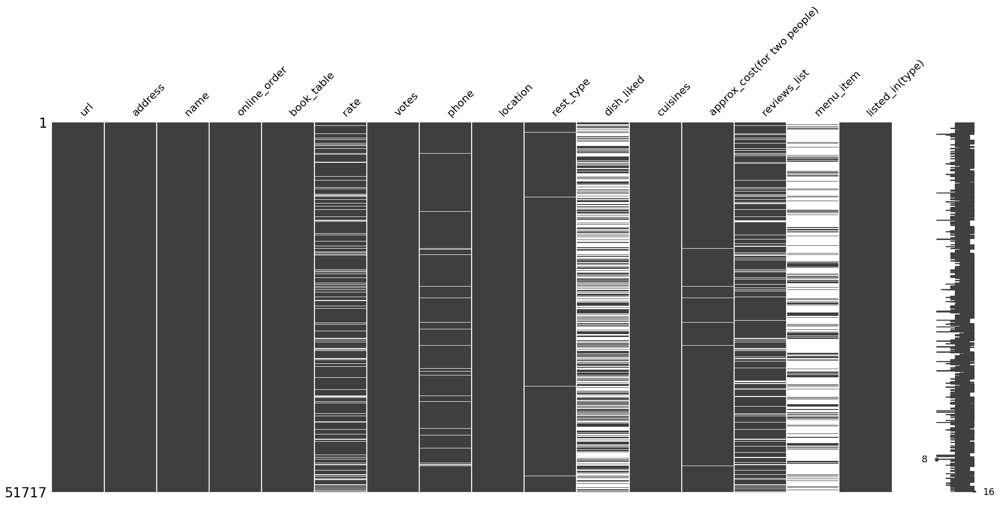

In [392]:
msno.matrix(zomato_cleaned)

# Handling duplicate rows

In [393]:
zomato_cleaned_new = zomato_cleaned[zomato_cleaned["rate"].astype(str).str.strip().str.upper() == "NEW"].copy()
zomato_cleaned_old = zomato_cleaned[zomato_cleaned["rate"].astype(str).str.strip().str.upper() != "NEW"].copy()
zomato_cleaned_old["rate"] = pd.to_numeric(zomato_cleaned_old["rate"], errors="coerce")

def merge_unique_lists(series):
    combined = []
    for item in series.dropna():
        if isinstance(item, list):
            combined.extend(item)
        else:
            combined.append(item)
    return list(set(filter(pd.notna, combined)))

merged_clean = zomato_cleaned_old.groupby(["name", "address", "location"]).agg({
    "rate": "mean",
    "votes": "mean",
    "approx_cost(for two people)": "mean",
    "online_order": lambda x: x.mode().iloc[0],
    "book_table": lambda x: x.mode().iloc[0],
    "url": lambda x: list(set(x)),
    "phone": merge_unique_lists,
    "dish_liked": merge_unique_lists,
    "cuisines": merge_unique_lists,
    "menu_item": merge_unique_lists,
    "rest_type": merge_unique_lists,
    "listed_in(type)": merge_unique_lists,
    "reviews_list": merge_unique_lists}).reset_index()

merged_clean["rate"] = merged_clean["rate"].round(1)
merged_clean["votes"] = merged_clean["votes"].round(0)
merged_clean["approx_cost(for two people)"] = merged_clean["approx_cost(for two people)"].round(0)

zomato_deldup = pd.concat([merged_clean, zomato_cleaned_new], ignore_index=True)
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list
0,#FeelTheROLL,"Opposite Mantri Commercio, Outer Ring Road, De...",Bellandur,3.4,7.0,200.0,0,0,[https://www.zomato.com/bangalore/feeltheroll-...,"[+91 9108342079, +91 9886117901]",[],[Fast Food],[],[Quick Bites],[Delivery],"[[('Rated 5.0', ""RATED\n Had an egg chicken r..."
1,#L-81 Cafe,"Sector 6, HSR Layout, HSR",HSR,3.9,48.0,400.0,1,0,[https://www.zomato.com/bangalore/l-81-cafe-hs...,[+91 9986210891],[Burgers],"[Fast Food, Beverages]",[],[Quick Bites],"[Delivery, Dine-out]","[[('Rated 4.0', 'RATED\n This little cafe is ..."
2,#Vibes Restro,"Marasur Gate, Chandapura - Anekal Road, Near A...",Electronic City,NaN,0.0,700.0,0,0,[https://www.zomato.com/bangalore/vibes-restro...,[+91 9538911285],[],"[Continental, Chinese, Italian]",[],[Casual Dining],"[Buffet, Delivery, Dine-out]","[[('Rated 5.0', ""RATED\n Great service and do..."
3,#refuel,"7, Ground Floor, RR Commercial Complex, Akshay...",Bannerghatta Road,3.7,37.0,400.0,1,0,[https://www.zomato.com/bangalore/refuel-banne...,[+91 8971227222],"[Mocktails, Sandwiches, Thick Shakes, Pasta]","[Beverages, Cafe]","[Pink Sauce Pasta, Ginger Tea, Chilli Lemon Fr...",[Cafe],"[Cafes, Delivery, Dine-out]","[[('Rated 3.0', 'RATED\n We ordered for Schez..."
4,'Brahmins' Thatte Idli,"19, 1st main, 2nd cross, 3rd stage, 3rd block,...",Basaveshwara Nagar,NaN,0.0,100.0,1,0,[https://www.zomato.com/bangalore/brahmins-tha...,"[+91 9902102665, +91 9148013543]",[],[South Indian],"[Khara Bhath and Vada Combo, Puliogare and Vad...",[Quick Bites],[Dine-out],[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,Wow Tiffin Food,"Near Rama Temple, Immadihalli Road, Whitefield...",Whitefield,NEW,0.0,200.0,0,0,https://www.zomato.com/bangalore/wow-tiffin-fo...,[+91 9535041209],NaN,[North Indian],NaN,[Quick Bites],Dine-out,NaN
14287,Quick Bites,"119/5, Pattandur Agrahara, Near Brigade Tech p...",Whitefield,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/quick-bites-w...,"[+91 9742377087, +91 7899303299]",NaN,[Chinese],"[Veg Chowmein + Manchurian, Paratha + Chicken ...",[Quick Bites],Dine-out,"[('Rated 5.0', 'RATED\n This is an awesome pl..."
14288,Shiv sagar,"Shop No 10, Food Court, 2nd Floor, Phoenix Mar...",Whitefield,NEW,0.0,250.0,1,0,https://www.zomato.com/bangalore/shiv-sagar-1-...,"[+91 9513300048, +91 8067266097]",NaN,"[South Indian, Chinese, North Indian]","[Malai Paneer Tikka, Paneer Kofta, Mushroom Ma...","[Quick Bites, Food Court]",Dine-out,"[('Rated 3.0', 'RATED\n A highly expensive pl..."
14289,Nawab Di Biryani,"17, Thubarahalli Village, Hobli, Varthur Main ...",Whitefield,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/nawab-di-biry...,"[+91 7899298400, +91 9818654628]",NaN,"[Biryani, Mughlai]",NaN,"[Takeaway, Delivery]",Dine-out,"[('Rated 3.0', 'RATED\n Biriyani had ordered ..."


In [394]:
zomato_deldup["phone"] = zomato_deldup["phone"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup["dish_liked"] = zomato_deldup["dish_liked"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup["cuisines"] = zomato_deldup["cuisines"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup["menu_item"] = zomato_deldup["menu_item"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup["rest_type"] = zomato_deldup["rest_type"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup["reviews_list"] = zomato_deldup["reviews_list"].apply(lambda x: np.nan if x == [] else x)

zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list
0,#FeelTheROLL,"Opposite Mantri Commercio, Outer Ring Road, De...",Bellandur,3.4,7.0,200.0,0,0,[https://www.zomato.com/bangalore/feeltheroll-...,"[+91 9108342079, +91 9886117901]",NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 5.0', ""RATED\n Had an egg chicken r..."
1,#L-81 Cafe,"Sector 6, HSR Layout, HSR",HSR,3.9,48.0,400.0,1,0,[https://www.zomato.com/bangalore/l-81-cafe-hs...,[+91 9986210891],[Burgers],"[Fast Food, Beverages]",NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 4.0', 'RATED\n This little cafe is ..."
2,#Vibes Restro,"Marasur Gate, Chandapura - Anekal Road, Near A...",Electronic City,NaN,0.0,700.0,0,0,[https://www.zomato.com/bangalore/vibes-restro...,[+91 9538911285],NaN,"[Continental, Chinese, Italian]",NaN,[Casual Dining],"[Buffet, Delivery, Dine-out]","[[('Rated 5.0', ""RATED\n Great service and do..."
3,#refuel,"7, Ground Floor, RR Commercial Complex, Akshay...",Bannerghatta Road,3.7,37.0,400.0,1,0,[https://www.zomato.com/bangalore/refuel-banne...,[+91 8971227222],"[Mocktails, Sandwiches, Thick Shakes, Pasta]","[Beverages, Cafe]","[Pink Sauce Pasta, Ginger Tea, Chilli Lemon Fr...",[Cafe],"[Cafes, Delivery, Dine-out]","[[('Rated 3.0', 'RATED\n We ordered for Schez..."
4,'Brahmins' Thatte Idli,"19, 1st main, 2nd cross, 3rd stage, 3rd block,...",Basaveshwara Nagar,NaN,0.0,100.0,1,0,[https://www.zomato.com/bangalore/brahmins-tha...,"[+91 9902102665, +91 9148013543]",NaN,[South Indian],"[Khara Bhath and Vada Combo, Puliogare and Vad...",[Quick Bites],[Dine-out],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,Wow Tiffin Food,"Near Rama Temple, Immadihalli Road, Whitefield...",Whitefield,NEW,0.0,200.0,0,0,https://www.zomato.com/bangalore/wow-tiffin-fo...,[+91 9535041209],NaN,[North Indian],NaN,[Quick Bites],Dine-out,NaN
14287,Quick Bites,"119/5, Pattandur Agrahara, Near Brigade Tech p...",Whitefield,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/quick-bites-w...,"[+91 9742377087, +91 7899303299]",NaN,[Chinese],"[Veg Chowmein + Manchurian, Paratha + Chicken ...",[Quick Bites],Dine-out,"[('Rated 5.0', 'RATED\n This is an awesome pl..."
14288,Shiv sagar,"Shop No 10, Food Court, 2nd Floor, Phoenix Mar...",Whitefield,NEW,0.0,250.0,1,0,https://www.zomato.com/bangalore/shiv-sagar-1-...,"[+91 9513300048, +91 8067266097]",NaN,"[South Indian, Chinese, North Indian]","[Malai Paneer Tikka, Paneer Kofta, Mushroom Ma...","[Quick Bites, Food Court]",Dine-out,"[('Rated 3.0', 'RATED\n A highly expensive pl..."
14289,Nawab Di Biryani,"17, Thubarahalli Village, Hobli, Varthur Main ...",Whitefield,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/nawab-di-biry...,"[+91 7899298400, +91 9818654628]",NaN,"[Biryani, Mughlai]",NaN,"[Takeaway, Delivery]",Dine-out,"[('Rated 3.0', 'RATED\n Biriyani had ordered ..."


In [395]:
rest_type_dict = {}

for row in zomato_deldup["rest_type"].dropna():
    for item in row:
        if item in rest_type_dict:
            rest_type_dict[item] += 1
        else:
            rest_type_dict[item] = 1

rest_type_df = pd.DataFrame(list(rest_type_dict.items()), columns=["rest_type", "count"])
rest_type_df

,rest_type,count
0,Quick Bites,6365
1,Casual Dining,2899
2,Cafe,870
3,Dessert Parlor,849
4,Bar,398
5,Fine Dining,93
6,Pub,155
7,Delivery,1869
8,Takeaway,896
9,Beverage Shop,487


In [396]:
dish_liked_dict = {}

for row in zomato_deldup["dish_liked"].dropna():
    for item in row:
        if item in dish_liked_dict:
            dish_liked_dict[item] += 1
        else:
            dish_liked_dict[item] = 1

dish_liked_df = pd.DataFrame(list(dish_liked_dict.items()), columns=["dish_liked", "count"])
dish_liked_df

,dish_liked,count
0,Burgers,506
1,Mocktails,284
2,Sandwiches,301
3,Thick Shakes,59
4,Pasta,547
...,...,...
2787,Smokey Marzano Pizza,2
2788,Katsu Curry,2
2789,Paneer Achari Roll,2
2790,Aloo Gobhi Masala,2


In [397]:
cuisines_dict = {}

for row in zomato_deldup["cuisines"].dropna():
    for item in row:
        if item in cuisines_dict:
            cuisines_dict[item] += 1
        else:
            cuisines_dict[item] = 1

cuisines_df = pd.DataFrame(list(cuisines_dict.items()), columns=["cuisines", "count"])
cuisines_df

,cuisines,count
0,Fast Food,2528
1,Beverages,1364
2,Continental,1195
3,Chinese,4189
4,Italian,639
...,...,...
102,Russian,1
103,Raw Meats,1
104,Belgian,2
105,Cantonese,1


In [398]:
menu_dict = {}

for row in list(zomato_deldup["menu_item"].dropna()):
    for item in row:
        if item in menu_dict:
            menu_dict[item] += 1
        else:
            menu_dict[item] = 1
menu_dict_clean = {
    re.sub(r"\s*\([^)]*\)", "", k).strip(): v
    for k, v in menu_dict.items()}

menu_df = pd.DataFrame(list(menu_dict_clean.items()), columns=["menu_item", "count"])
menu_df

,menu_item,count
0,Pink Sauce Pasta,8
1,Ginger Tea,106
2,Chilli Lemon Fries,1
3,Veg Sticks,2
4,Orange,7
...,...,...
134645,Veg Chowmein + Manchurian,2
134646,Paratha + Chicken Masala,2
134647,2 Paratha + 2 Chicken,2
134648,Chilli Paneer + Veg Fried Rice,1


In [399]:
zomato_deldup.describe()

,votes,approx_cost(for two people),online_order,book_table
count,14291.000000,14231.000000,14291.000000,14291.000000
mean,159.634035,482.506430,0.515359,0.074522
std,560.027936,381.397863,0.499782,0.262628
min,0.000000,40.000000,0.000000,0.000000
25%,0.000000,250.000000,0.000000,0.000000
50%,16.000000,400.000000,1.000000,0.000000
75%,95.000000,600.000000,1.000000,0.000000
max,16588.000000,6000.000000,1.000000,1.000000


In [400]:
zomato_deldup.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14291 entries, 0 to 14290
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         14291 non-null  object 
 1   address                      14291 non-null  object 
 2   location                     14291 non-null  object 
 3   rate                         11801 non-null  object 
 4   votes                        14291 non-null  float64
 5   approx_cost(for two people)  14231 non-null  float64
 6   online_order                 14291 non-null  int64  
 7   book_table                   14291 non-null  int64  
 8   url                          14291 non-null  object 
 9   phone                        13971 non-null  object 
 10  dish_liked                   4797 non-null   object 
 11  cuisines                     14272 non-null  object 
 12  menu_item                    4903 non-null   object 
 13  rest_type       

In [401]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                           2490
votes                             0
approx_cost(for two people)      60
online_order                      0
book_table                        0
url                               0
phone                           320
dish_liked                     9494
cuisines                         19
menu_item                      9388
rest_type                        65
listed_in(type)                   0
reviews_list                   3312
dtype: int64

# Imputation of Approx_Cost

In [402]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsRegressor

train_df = zomato_deldup[zomato_deldup["approx_cost(for two people)"].notnull()].copy()
impute_df = zomato_deldup[zomato_deldup["approx_cost(for two people)"].isnull()].copy()

features = ["votes", "location"]
target = "approx_cost(for two people)"

X_train = train_df[features]
y_train = train_df[target]

X_to_impute = impute_df[features]

numeric_features = ["votes"]
categorical_features = ["location"]

preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), numeric_features),
        ("cat", OneHotEncoder(handle_unknown= "ignore"), categorical_features)
    ])

model_pipeline = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("regressor", KNeighborsRegressor(n_neighbors=3))
])

model_pipeline.fit(X_train, y_train)

predicted_rates = model_pipeline.predict(X_to_impute)

zomato_deldup.loc[zomato_deldup["approx_cost(for two people)"].isnull(), "approx_cost(for two people)"] = predicted_rates.round(0)
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list
0,#FeelTheROLL,"Opposite Mantri Commercio, Outer Ring Road, De...",Bellandur,3.4,7.0,200.0,0,0,[https://www.zomato.com/bangalore/feeltheroll-...,"[+91 9108342079, +91 9886117901]",NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 5.0', ""RATED\n Had an egg chicken r..."
1,#L-81 Cafe,"Sector 6, HSR Layout, HSR",HSR,3.9,48.0,400.0,1,0,[https://www.zomato.com/bangalore/l-81-cafe-hs...,[+91 9986210891],[Burgers],"[Fast Food, Beverages]",NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 4.0', 'RATED\n This little cafe is ..."
2,#Vibes Restro,"Marasur Gate, Chandapura - Anekal Road, Near A...",Electronic City,NaN,0.0,700.0,0,0,[https://www.zomato.com/bangalore/vibes-restro...,[+91 9538911285],NaN,"[Continental, Chinese, Italian]",NaN,[Casual Dining],"[Buffet, Delivery, Dine-out]","[[('Rated 5.0', ""RATED\n Great service and do..."
3,#refuel,"7, Ground Floor, RR Commercial Complex, Akshay...",Bannerghatta Road,3.7,37.0,400.0,1,0,[https://www.zomato.com/bangalore/refuel-banne...,[+91 8971227222],"[Mocktails, Sandwiches, Thick Shakes, Pasta]","[Beverages, Cafe]","[Pink Sauce Pasta, Ginger Tea, Chilli Lemon Fr...",[Cafe],"[Cafes, Delivery, Dine-out]","[[('Rated 3.0', 'RATED\n We ordered for Schez..."
4,'Brahmins' Thatte Idli,"19, 1st main, 2nd cross, 3rd stage, 3rd block,...",Basaveshwara Nagar,NaN,0.0,100.0,1,0,[https://www.zomato.com/bangalore/brahmins-tha...,"[+91 9902102665, +91 9148013543]",NaN,[South Indian],"[Khara Bhath and Vada Combo, Puliogare and Vad...",[Quick Bites],[Dine-out],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,Wow Tiffin Food,"Near Rama Temple, Immadihalli Road, Whitefield...",Whitefield,NEW,0.0,200.0,0,0,https://www.zomato.com/bangalore/wow-tiffin-fo...,[+91 9535041209],NaN,[North Indian],NaN,[Quick Bites],Dine-out,NaN
14287,Quick Bites,"119/5, Pattandur Agrahara, Near Brigade Tech p...",Whitefield,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/quick-bites-w...,"[+91 9742377087, +91 7899303299]",NaN,[Chinese],"[Veg Chowmein + Manchurian, Paratha + Chicken ...",[Quick Bites],Dine-out,"[('Rated 5.0', 'RATED\n This is an awesome pl..."
14288,Shiv sagar,"Shop No 10, Food Court, 2nd Floor, Phoenix Mar...",Whitefield,NEW,0.0,250.0,1,0,https://www.zomato.com/bangalore/shiv-sagar-1-...,"[+91 9513300048, +91 8067266097]",NaN,"[South Indian, Chinese, North Indian]","[Malai Paneer Tikka, Paneer Kofta, Mushroom Ma...","[Quick Bites, Food Court]",Dine-out,"[('Rated 3.0', 'RATED\n A highly expensive pl..."
14289,Nawab Di Biryani,"17, Thubarahalli Village, Hobli, Varthur Main ...",Whitefield,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/nawab-di-biry...,"[+91 7899298400, +91 9818654628]",NaN,"[Biryani, Mughlai]",NaN,"[Takeaway, Delivery]",Dine-out,"[('Rated 3.0', 'RATED\n Biriyani had ordered ..."


In [403]:
zomato_deldup = zomato_deldup.sample(frac=1).reset_index(drop=True)
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro..."
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,NaN,0.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo..."
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E..."
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,NaN,0.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,NaN,[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,NEW,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f..."
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]",NaN,"[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in..."


In [404]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                           2490
votes                             0
approx_cost(for two people)       0
online_order                      0
book_table                        0
url                               0
phone                           320
dish_liked                     9494
cuisines                         19
menu_item                      9388
rest_type                        65
listed_in(type)                   0
reviews_list                   3312
dtype: int64

# Imputation of Rates

In [405]:
conditions = [
    (zomato_deldup["rate"] == "NEW"),
    (zomato_deldup["votes"] < 20)]

choices = ["New","Votes < 20"]

zomato_deldup["rating_category"] = np.select(
    conditions, 
    choices, 
    default="Votes >= 20")

zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,NaN,0.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,NaN,0.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,NaN,[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,NEW,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]",NaN,"[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20


In [406]:
rating_pattern = r"Rated\s*(\d+(?:\.\d+)?)"

def get_review_imputation_data(row):
    
    is_imputable_rate = pd.isna(row["rate"]) or (row["rate"] == "NEW")
    
    if not is_imputable_rate:
        return pd.NA, pd.NA 
    
    reviews_list_of_strings = row["reviews_list"]
    extracted_ratings = []

    if isinstance(reviews_list_of_strings, list):
        for review_string in reviews_list_of_strings:
            try:
                actual_list_of_tuples = ast.literal_eval(review_string)
                
                if isinstance(actual_list_of_tuples, list):
                    for review_tuple in actual_list_of_tuples:
                        if isinstance(review_tuple, tuple) and len(review_tuple) > 0:
                            match = re.search(rating_pattern, str(review_tuple[0]))
                            if match:
                                extracted_ratings.append(float(match.group(1)))
            except:
                continue

    if extracted_ratings:
        new_avg = np.mean(extracted_ratings)
        new_count = len(extracted_ratings)
        
        return round(new_avg, 1), new_count
    
    return pd.NA, pd.NA

zomato_deldup[["review_imputed_rate", "review_imputed_votes"]] = zomato_deldup.apply(
    get_review_imputation_data, 
    axis=1, 
    result_type="expand")

zomato_deldup["review_imputed_rate"] = pd.to_numeric(zomato_deldup["review_imputed_rate"])
zomato_deldup["review_imputed_votes"] = pd.to_numeric(zomato_deldup["review_imputed_votes"])

zomato_deldup["votes"] = np.where(
    zomato_deldup["review_imputed_votes"].notna(), 
    zomato_deldup["review_imputed_votes"], 
    zomato_deldup["votes"])

zomato_deldup = zomato_deldup.drop(columns=["review_imputed_votes"])
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category,review_imputed_rate
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20,NaN
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New,NaN
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,NaN,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20,1.7
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New,NaN
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,NaN,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,NaN,[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20,3.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,NEW,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New,NaN
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New,NaN
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20,NaN
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]",NaN,"[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20,NaN


In [407]:
target_col = "rate"
numeric_feature_col = "approx_cost(for two people)"
categorical_feature_col = "location"

features = [numeric_feature_col, categorical_feature_col]

impute_mask = (zomato_deldup[target_col].isnull()) | (zomato_deldup[target_col] == "NEW")

train_df = zomato_deldup[~impute_mask].copy()
impute_df = zomato_deldup[impute_mask].copy()

X_train = train_df[features]
y_train = train_df[target_col].astype(float) 
X_to_impute = impute_df[features]

numeric_features = [numeric_feature_col]
categorical_features = [categorical_feature_col]

preprocessor = ColumnTransformer(
    transformers=[
        ("num", StandardScaler(), numeric_features),
        ("cat", OneHotEncoder(handle_unknown="ignore"), categorical_features)])

model_pipeline = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("regressor", KNeighborsRegressor(n_neighbors=3))
])

model_pipeline.fit(X_train, y_train)
predicted_new_rates = model_pipeline.predict(X_to_impute)
rounded_rates = np.round(predicted_new_rates, 1)

zomato_deldup["knn_imputed_rate"] = np.nan

zomato_deldup.loc[impute_mask, "knn_imputed_rate"] = rounded_rates
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category,review_imputed_rate,knn_imputed_rate
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20,NaN,NaN
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New,NaN,3.6
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,NaN,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20,1.7,3.6
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,NEW,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New,NaN,3.7
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,NaN,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,NaN,[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20,3.5,3.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,NEW,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New,NaN,3.6
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,NEW,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New,NaN,3.5
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20,NaN,NaN
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]",NaN,"[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20,NaN,NaN


In [408]:
zomato_deldup.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14291 entries, 0 to 14290
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         14291 non-null  object 
 1   address                      14291 non-null  object 
 2   location                     14291 non-null  object 
 3   rate                         11801 non-null  object 
 4   votes                        14291 non-null  float64
 5   approx_cost(for two people)  14291 non-null  float64
 6   online_order                 14291 non-null  int64  
 7   book_table                   14291 non-null  int64  
 8   url                          14291 non-null  object 
 9   phone                        13971 non-null  object 
 10  dish_liked                   4797 non-null   object 
 11  cuisines                     14272 non-null  object 
 12  menu_item                    4903 non-null   object 
 13  rest_type       

In [409]:
zomato_deldup["rate"] = zomato_deldup["rate"].replace(["NEW"], np.nan)

cond_both = (
    zomato_deldup["knn_imputed_rate"].notna() & 
    zomato_deldup["review_imputed_rate"].notna())

cond_only_knn = (
    zomato_deldup["knn_imputed_rate"].notna() & 
    zomato_deldup["review_imputed_rate"].isna())

average_rate = (zomato_deldup["knn_imputed_rate"] + zomato_deldup["review_imputed_rate"]) / 2
rounded_average = average_rate.round(1)

zomato_deldup["rate"] = np.where(
    cond_both, 
    rounded_average, 
    zomato_deldup["rate"])

zomato_deldup["rate"] = np.where(
    cond_only_knn, 
    zomato_deldup["knn_imputed_rate"], 
    zomato_deldup["rate"])

zomato_deldup = zomato_deldup.drop(columns=[
    "knn_imputed_rate", 
    "review_imputed_rate"])

zomato_deldup

C:\Users\SAKETH PRANAV\AppData\Local\Temp\ipykernel_3300\2815573777.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  zomato_deldup["rate"] = zomato_deldup["rate"].replace(["NEW"], np.nan)


,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,3.6,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,2.6,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],NaN,[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,3.7,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,3.6,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,NaN,[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,3.6,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,3.5,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]",NaN,"[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20


In [410]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                              0
votes                             0
approx_cost(for two people)       0
online_order                      0
book_table                        0
url                               0
phone                           320
dish_liked                     9494
cuisines                         19
menu_item                      9388
rest_type                        65
listed_in(type)                   0
reviews_list                   3312
rating_category                   0
dtype: int64

# Imputation of Dish_liked from Reviews_list

In [411]:
menu_df

,menu_item,count
0,Pink Sauce Pasta,8
1,Ginger Tea,106
2,Chilli Lemon Fries,1
3,Veg Sticks,2
4,Orange,7
...,...,...
134645,Veg Chowmein + Manchurian,2
134646,Paratha + Chicken Masala,2
134647,2 Paratha + 2 Chicken,2
134648,Chilli Paneer + Veg Fried Rice,1


In [412]:
dish_liked_df

,dish_liked,count
0,Burgers,506
1,Mocktails,284
2,Sandwiches,301
3,Thick Shakes,59
4,Pasta,547
...,...,...
2787,Smokey Marzano Pizza,2
2788,Katsu Curry,2
2789,Paneer Achari Roll,2
2790,Aloo Gobhi Masala,2


In [413]:
dish_liked_df["is_in_menu_df"] = dish_liked_df["dish_liked"].isin(menu_df["menu_item"])
dish_liked_df

,dish_liked,count,is_in_menu_df
0,Burgers,506,False
1,Mocktails,284,True
2,Sandwiches,301,False
3,Thick Shakes,59,False
4,Pasta,547,True
...,...,...,...
2787,Smokey Marzano Pizza,2,False
2788,Katsu Curry,2,False
2789,Paneer Achari Roll,2,True
2790,Aloo Gobhi Masala,2,True


In [414]:
dish_lookup_list = [
    (original_dish, str(original_dish).lower()) 
    for original_dish in dish_liked_df["dish_liked"].dropna().unique()]

ind = zomato_deldup[zomato_deldup["reviews_list"].notna()].index

for i in ind:
    current_val = zomato_deldup.at[i, "dish_liked"]
    if isinstance(current_val, list):
        is_empty = (len(current_val) == 0)
    else:
        is_empty = pd.isna(current_val)

    if is_empty:
        all_review_matches = set()
        reviews_list_of_strings = zomato_deldup.at[i, "reviews_list"]
        if not isinstance(reviews_list_of_strings, list):
            continue
            
        for review_string in reviews_list_of_strings:
            try:
                actual_list_of_tuples = ast.literal_eval(review_string)
                
                if isinstance(actual_list_of_tuples, list):
                    for review_tuple in actual_list_of_tuples:
                
                        if (isinstance(review_tuple, tuple) and len(review_tuple) == 2 and
                            review_tuple[0] is not None and isinstance(review_tuple[1], str) and 
                            float(review_tuple[0].replace("Rated ", "")) >= 3):
                            
                            review_text_lower = review_tuple[1].lower()
                            
                            for original_dish, lower_dish in dish_lookup_list:
                                if lower_dish in review_text_lower:
                                    all_review_matches.add(original_dish)

            except:
                continue
        
        if len(all_review_matches) > 0:
            zomato_deldup.at[i, "dish_liked"] = list(all_review_matches)
            
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,3.6,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,2.6,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],"[Vada, Vada Pav, Lassi, Chaat]",[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,3.7,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,3.6,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,"[Biryani, Fish]",[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,3.6,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,3.5,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]","[Vegetarian, Churma, Dal Bati, Chicken, Fish, ...","[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20


In [415]:
junk_items = ["Friendly Staff", "Courteous Staff", "Decor", "Dj", "Bbq"]
junk_items_lower = {item.lower() for item in junk_items}

def clean_dish_liked(dish_list):
    if isinstance(dish_list, list):
        cleaned_list = [item for item in dish_list if str(item).lower() not in junk_items_lower]
        
        if len(cleaned_list) == 0:
            return np.nan
        else:
            return cleaned_list
    else:
        return dish_list

zomato_deldup["dish_liked"] = zomato_deldup["dish_liked"].apply(clean_dish_liked)
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,3.6,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,2.6,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],"[Vada, Vada Pav, Lassi, Chaat]",[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,3.7,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,3.6,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,"[Biryani, Fish]",[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,3.6,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,3.5,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]","[Vegetarian, Churma, Dal Bati, Chicken, Fish, ...","[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20


In [416]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                              0
votes                             0
approx_cost(for two people)       0
online_order                      0
book_table                        0
url                               0
phone                           320
dish_liked                     5166
cuisines                         19
menu_item                      9388
rest_type                        65
listed_in(type)                   0
reviews_list                   3312
rating_category                   0
dtype: int64

# Imputation of Rest_types

In [417]:
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier

missing_index = zomato_deldup[zomato_deldup["rest_type"].isna()].index
zomato_deldup["listed_in(type)"] = zomato_deldup["listed_in(type)"].apply(lambda x: [] if isinstance(x, float) else x)
train_df = zomato_deldup.dropna(subset=["rest_type"])
impute_df = zomato_deldup.loc[missing_index]

mlb_x = MultiLabelBinarizer()
X_train = mlb_x.fit_transform(train_df["listed_in(type)"])
X_impute = mlb_x.transform(impute_df["listed_in(type)"])

mlb_y = MultiLabelBinarizer()
y_train = mlb_y.fit_transform(train_df["rest_type"])

base_model = RandomForestClassifier(random_state=42)
multi_label_model = MultiOutputClassifier(base_model, n_jobs=-1)
multi_label_model.fit(X_train, y_train)

y_pred_binary = multi_label_model.predict(X_impute)
y_pred_lists = [list(t) for t in mlb_y.inverse_transform(y_pred_binary)]

zomato_deldup["rest_type"] = zomato_deldup["rest_type"].astype(object)

imputed_values = pd.Series(y_pred_lists, index=missing_index)

zomato_deldup.loc[missing_index, "rest_type"] = imputed_values
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),reviews_list,rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]","[[('Rated 4.0', 'RATED\n So, I went for a pro...",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,3.6,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,NaN,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,2.6,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],"[Vada, Vada Pav, Lassi, Chaat]",[Fast Food],NaN,[Quick Bites],[Delivery],"[[('Rated 1.0', ""RATED\n This is my life's wo...",Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,3.7,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,"[('Rated 3.0', 'RATED\n Located opposite to E...",New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,3.6,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,"[Biryani, Fish]",[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]","[[('Rated 3.5', 'RATED\n In t busy streets, c...",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,3.6,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,NaN,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,3.5,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,NaN,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]","[[('Rated 5.0', 'RATED\n Been to this place f...",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]","[Vegetarian, Churma, Dal Bati, Chicken, Fish, ...","[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],"[[('Rated 4.0', 'RATED\n May be only place in...",Votes >= 20


In [418]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                              0
votes                             0
approx_cost(for two people)       0
online_order                      0
book_table                        0
url                               0
phone                           320
dish_liked                     5166
cuisines                         19
menu_item                      9388
rest_type                         0
listed_in(type)                   0
reviews_list                   3312
rating_category                   0
dtype: int64

# Dealing with missing Cuisines

In [419]:
zomato_deldup = zomato_deldup.dropna(subset=["cuisines"])

In [420]:
zomato_deldup.isnull().sum()

name                              0
address                           0
location                          0
rate                              0
votes                             0
approx_cost(for two people)       0
online_order                      0
book_table                        0
url                               0
phone                           308
dish_liked                     5148
cuisines                          0
menu_item                      9372
rest_type                         0
listed_in(type)                   0
reviews_list                   3298
rating_category                   0
dtype: int64

<Axes: >

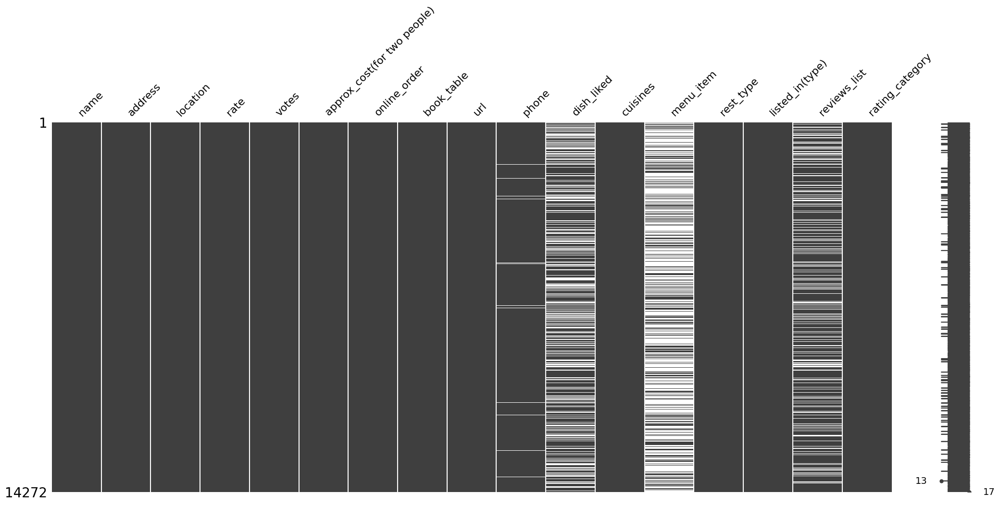

In [421]:
msno.matrix(zomato_deldup)

In [422]:
zomato_deldup = zomato_deldup.drop(columns= "reviews_list")
zomato_deldup

,name,address,location,rate,votes,approx_cost(for two people),online_order,book_table,url,phone,dish_liked,cuisines,menu_item,rest_type,listed_in(type),rating_category
0,The Raj Pavilion - ITC Windsor,"ITC Windsor, 25 Windsor Square, Sankey Road, B...",Sankey Road,4.2,371.0,2400.0,0,1,[https://www.zomato.com/bangalore/the-raj-pavi...,[080-6140-1224],"[Creme Brulee, Sunday Brunch, Hot Chocolate, S...","[Continental, Asian, North Indian]",NaN,[Fine Dining],"[Buffet, Dine-out]",Votes >= 20
1,X Cafe,"19, Mantho Convention Center, Shanti Nagar, Ba...",Shanti Nagar,3.6,0.0,400.0,0,0,https://www.zomato.com/bangalore/x-cafe-shanti...,[+91 8861384540],NaN,"[American, Cafe, Chinese, Italian, Desserts]",NaN,[Cafe],Dine-out,New
2,Chaat Chatore,"31, 21st Cross, Rammaih Garden, 24th Main, 7th...",JP Nagar,2.6,3.0,300.0,0,0,[https://www.zomato.com/bangalore/chaat-chator...,[+91 8880842620],"[Vada, Vada Pav, Lassi, Chaat]",[Fast Food],NaN,[Quick Bites],[Delivery],Votes < 20
3,Kasol Cafe,"Shop 3, Opposite ESI Hospital Quarter, Double ...",Indiranagar,3.7,0.0,400.0,0,0,https://www.zomato.com/bangalore/kasol-cafe-1-...,[+91 9886751605],NaN,"[Bengali, Continental]",NaN,[Quick Bites],Delivery,New
4,Apsara Hotel,Opposite Russel Market Auto Stand,Shivajinagar,3.6,1.0,150.0,0,0,[https://www.zomato.com/bangalore/apsara-hotel...,NaN,"[Biryani, Fish]",[North Indian],NaN,[Quick Bites],"[Delivery, Dine-out]",Votes < 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14286,The Munch Box,"Teacher's Colony, HSR Layout, 5th Sector, Beng...",HSR,3.6,0.0,300.0,0,0,https://www.zomato.com/bangalore/the-munch-box...,[+91 7259783876],NaN,"[American, Chinese]",NaN,[Quick Bites],Dine-out,New
14287,Shake The Shake,"39, 18th Main, 7th Cross, BTM 1st Stage Opposi...",BTM,3.5,0.0,200.0,1,0,https://www.zomato.com/bangalore/shake-the-sha...,[+91 9036011861],NaN,[Juices],NaN,[Beverage Shop],Delivery,New
14288,"Lush - Renaissance Hotel, Bengaluru","17 and 17/1 Madhavanagar Extension, Race Cours...",Race Course Road,4.5,414.0,1200.0,0,1,[https://www.zomato.com/bangalore/lush-renaiss...,"[080-4965-2951, +91 8046855527, +91 9663153361]","[Biryani, Chicken Tikka, Tea, Paneer Tikka, Mo...","[Continental, North Indian]",NaN,[Casual Dining],"[Buffet, Dine-out]",Votes >= 20
14289,Jai Bhawani,"Sri Grand Inn, 99, 2nd Main, Gandhi Nagar, Maj...",Majestic,3.6,21.0,600.0,0,0,[https://www.zomato.com/bangalore/jai-bhawani-...,"[080-4110-2928, +91 9591671793]","[Vegetarian, Churma, Dal Bati, Chicken, Fish, ...","[South Indian, Chinese, North Indian]",NaN,[Casual Dining],[Dine-out],Votes >= 20


In [423]:
zomato_deldup.to_csv("zomato_final.csv", index=False)

In [424]:
zomato_deldup.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14272 entries, 0 to 14290
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   name                         14272 non-null  object 
 1   address                      14272 non-null  object 
 2   location                     14272 non-null  object 
 3   rate                         14272 non-null  float64
 4   votes                        14272 non-null  float64
 5   approx_cost(for two people)  14272 non-null  float64
 6   online_order                 14272 non-null  int64  
 7   book_table                   14272 non-null  int64  
 8   url                          14272 non-null  object 
 9   phone                        13964 non-null  object 
 10  dish_liked                   9124 non-null   object 
 11  cuisines                     14272 non-null  object 
 12  menu_item                    4900 non-null   object 
 13  rest_type            